In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
%matplotlib inline

import statsmodels.api as sm
import statsmodels.formula.api as smf
import patsy
import scipy.stats as stats
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression, LassoCV, RidgeCV, Lasso, Ridge
from sklearn.model_selection import KFold, cross_val_score, train_test_split


# Import Files

### NBA Salaries Table

In [3]:
# Import NBA salaries table
nba_salary = pd.read_csv('nba_salary2.csv')
nba_salary.head()

,Player,2021-22,2020-21,2019-20,2018-19,2017-18,2016-17,2015-16,2014-15,2013-14,...,2005-06,2004-05,2003-04,2002-03,2001-02,2000-01,1999-00,1998-99,1997-98,1996-97
0,Stephen Curry,45780966.0,45325029.0,42674629.0,40386520.0,38468739.0,13654081.0,12945956.0,12116632.0,11504868.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,James Harden,44310840.0,43479158.0,40518442.0,32960751.0,31388759.0,29918259.0,17896589.0,16750126.0,15904415.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,John Wall,44310840.0,43479158.0,40518442.0,20668989.0,20035826.0,17761997.0,16769198.0,15618561.0,8680071.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Russell Westbrook,44211146.0,43588654.0,40844595.0,38454209.0,31388759.0,29918259.0,19063757.0,17918740.0,17097246.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Kevin Durant,42018900.0,42271404.0,39457722.0,32346173.0,27729174.0,29918259.0,25015562.0,22795904.0,21843723.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### NBA Stats Table

In [4]:
# Import NBA stats table
nba_stats = pd.read_csv('nba_stats.csv')
nba_stats

,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,FG%,...,REB,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SEASON
0,Trae Young,23,76,40,36,2652,2155,711,1544,46.0,...,284,737,303,72,7,128,42,0,159,2021-22
1,DeMar DeRozan,32,76,43,33,2743,2118,774,1535,50.4,...,392,374,181,68,24,178,6,0,77,2021-22
2,Joel Embiid,28,68,45,23,2296,2079,666,1334,49.9,...,796,284,214,77,99,181,46,2,368,2021-22
3,Jayson Tatum,24,76,49,27,2731,2046,708,1564,45.3,...,609,334,217,75,49,174,22,0,667,2021-22
4,Nikola Jokic,27,74,46,28,2476,2004,764,1311,58.3,...,1019,584,281,109,63,191,66,19,444,2021-22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12302,Anthony Miller,25,1,0,1,14,0,0,5,0.0,...,7,0,0,0,0,2,0,0,-14,1996-97
12303,Bruce Bowen,26,1,1,0,1,0,0,0,0.0,...,0,0,0,0,1,0,0,0,3,1996-97
12304,Cuonzo Martin,25,3,0,3,13,0,0,7,0.0,...,1,1,1,0,0,1,0,0,-2,1996-97
12305,Derrick Alston,24,2,1,1,11,0,0,5,0.0,...,4,0,0,0,0,0,0,0,-7,1996-97


In [5]:
curry2 = nba_stats[nba_stats['PLAYER'] == 'Stephen Curry']
curry2

,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,FG%,...,REB,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SEASON
13,Stephen Curry,34,64,45,19,2211,1630,535,1224,43.7,...,335,404,206,85,23,130,12,2,509,2021-22
605,Stephen Curry,33,63,37,26,2152,2015,658,1365,48.2,...,345,363,213,77,8,119,8,0,244,2020-21
1529,Stephen Curry,32,5,1,4,139,104,33,82,40.2,...,26,33,16,5,2,11,1,0,-45,2019-20
1681,Stephen Curry,31,69,52,17,2331,1881,632,1340,47.2,...,369,361,192,92,25,166,3,0,689,2018-19
2233,Stephen Curry,30,51,41,10,1631,1346,428,864,49.5,...,261,310,153,80,8,114,5,0,486,2017-18
2751,Stephen Curry,29,79,65,14,2639,1999,675,1443,46.8,...,353,524,239,142,17,183,9,0,1015,2016-17
3231,Stephen Curry,28,79,71,8,2700,2375,805,1598,50.4,...,430,527,262,169,15,161,15,2,1022,2015-16
3707,Stephen Curry,27,80,67,13,2613,1900,653,1341,48.7,...,341,619,249,163,16,158,23,0,919,2014-15
4203,Stephen Curry,26,78,50,28,2846,1873,652,1383,47.1,...,334,666,294,128,14,194,28,4,574,2013-14
4686,Stephen Curry,25,78,45,33,2983,1786,626,1388,45.1,...,314,539,240,126,12,198,15,0,133,2012-13


**We see that all of the salaries throughout the years for one player is given in a SINGLE row of data for nba_salary,  whereas one player will have one row for each year of stats for nba_stats, i.e. multiple rows for one player.**

**Therefore, before we can merge, we would need to re-format nba_salary**

# Clean and Prep Data

In [6]:
# Re-format nba_salary so that each season salary is one row of data for each player
nba_salary2 = nba_salary.melt(id_vars=['Player'],
                      var_name='SEASON',
                      value_name='SALARY')
nba_salary2

,Player,SEASON,SALARY
0,Stephen Curry,2021-22,45780966.0
1,James Harden,2021-22,44310840.0
2,John Wall,2021-22,44310840.0
3,Russell Westbrook,2021-22,44211146.0
4,Kevin Durant,2021-22,42018900.0
...,...,...,...
64761,Brett Szabo,1996-97,381449.0
64762,Earl Cureton,1996-97,355788.0
64763,Kenny Smith,1996-97,329606.0
64764,Lloyd Daniels,1996-97,319203.0


In [7]:
# Check to see that each year/season corresponds to one row of data
curry3 = nba_salary2[nba_salary2['Player'] == 'Stephen Curry']
curry3

,Player,SEASON,SALARY
0,Stephen Curry,2021-22,45780966.0
2491,Stephen Curry,2020-21,45325029.0
4982,Stephen Curry,2019-20,42674629.0
7473,Stephen Curry,2018-19,40386520.0
9964,Stephen Curry,2017-18,38468739.0
12455,Stephen Curry,2016-17,13654081.0
14946,Stephen Curry,2015-16,12945956.0
17437,Stephen Curry,2014-15,12116632.0
19928,Stephen Curry,2013-14,11504868.0
22419,Stephen Curry,2012-13,4687047.0


**Notice that players will only have salary values in the years that they played, so we can drop all the rows without a salary value (or rows with null values).**

In [8]:
# Here's another way to see where null values are - over 51K missing values in SALARY column
nba_salary2.isnull().sum()

Player        0
SEASON        0
SALARY    51951
dtype: int64

In [9]:
# Drop all null values in nba_salary2
nba_salary3 = nba_salary2.dropna()
nba_salary3

,Player,SEASON,SALARY
0,Stephen Curry,2021-22,45780966.0
1,James Harden,2021-22,44310840.0
2,John Wall,2021-22,44310840.0
3,Russell Westbrook,2021-22,44211146.0
4,Kevin Durant,2021-22,42018900.0
...,...,...,...
64761,Brett Szabo,1996-97,381449.0
64762,Earl Cureton,1996-97,355788.0
64763,Kenny Smith,1996-97,329606.0
64764,Lloyd Daniels,1996-97,319203.0


In [10]:
nba_salary3.isnull().sum()

Player    0
SEASON    0
SALARY    0
dtype: int64

**# of rows dropped from 64K+ to 12K+, which is actually now more similar to the # of rows in our nba_stats table.**

In [11]:
# Some players' names have been changed or spelled incorrectly
# Let's update them in nba_stats table so that it'll match nba_salary3 table

nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("Enes Freedom", "Enes Kanter")
nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("Jr.", "Jr")
nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("Dennis Schroder", "Dennis Schroeder")
nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("Wendell Carter Jr", "Wendell Carter")
nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("Devonte' Graham", "Devonte Graham")
nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("Patty Mills", "Patrick Mills")
nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("Jre Holiday", "Jrue Holiday")
nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("Jr Holiday", "Jrue Holiday")
nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("JrHoliday", "Jrue Holiday")
nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("Lonnie Walker IV", "Lonnie Walker")
nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("Kenyon Martin Jr", "Kenyon Martin")
nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("P.J. Washington", "PJ Washington")


C:\Users\sandr\AppData\Local\Temp/ipykernel_6660/865748564.py:5: FutureWarning: The default value of regex will change from True to False in a future version.
  nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("Jr.", "Jr")
C:\Users\sandr\AppData\Local\Temp/ipykernel_6660/865748564.py:15: FutureWarning: The default value of regex will change from True to False in a future version.
  nba_stats['PLAYER'] = nba_stats['PLAYER'].str.replace("P.J. Washington", "PJ Washington")


**Of course, there are probably many more that need name modifications, but it'll be too tedious to correct them all.  Let's move on**

## Merge Files

In [12]:
# Merge the files, do an inner join to only join matching players on both tables
nba = pd.merge(nba_stats, nba_salary3.set_index('Player'), how='inner', left_on=['PLAYER', 'SEASON'], right_on=['Player', 'SEASON'])
nba.head()

,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,FG%,...,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SEASON,SALARY
0,Trae Young,23,76,40,36,2652,2155,711,1544,46.0,...,737,303,72,7,128,42,0,159,2021-22,8326471.0
1,DeMar DeRozan,32,76,43,33,2743,2118,774,1535,50.4,...,374,181,68,24,178,6,0,77,2021-22,26000000.0
2,Joel Embiid,28,68,45,23,2296,2079,666,1334,49.9,...,284,214,77,99,181,46,2,368,2021-22,31579390.0
3,Jayson Tatum,24,76,49,27,2731,2046,708,1564,45.3,...,334,217,75,49,174,22,0,667,2021-22,28103500.0
4,Nikola Jokic,27,74,46,28,2476,2004,764,1311,58.3,...,584,281,109,63,191,66,19,444,2021-22,31044906.0


## Save Merged File

In [ ]:
# Save as csv file
nba.to_csv('nba_merged.csv', encoding='utf-8', index=False)

In [2]:
#Call the file
nba = pd.read_csv('nba_merged.csv', encoding='utf-8')
nba.head()

,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,FG%,...,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SEASON,SALARY
0,Trae Young,23,76,40,36,2652,2155,711,1544,46.0,...,737,303,72,7,128,42,0,159,2021-22,8326471.0
1,DeMar DeRozan,32,76,43,33,2743,2118,774,1535,50.4,...,374,181,68,24,178,6,0,77,2021-22,26000000.0
2,Joel Embiid,28,68,45,23,2296,2079,666,1334,49.9,...,284,214,77,99,181,46,2,368,2021-22,31579390.0
3,Jayson Tatum,24,76,49,27,2731,2046,708,1564,45.3,...,334,217,75,49,174,22,0,667,2021-22,28103500.0
4,Nikola Jokic,27,74,46,28,2476,2004,764,1311,58.3,...,584,281,109,63,191,66,19,444,2021-22,31044906.0


# More Cleaning and Prepping Data

In [3]:
# Identify rows with null values in merged set, if any
df_null = nba[nba.isnull().any(axis=1)]
df_null

,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,FG%,...,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SEASON,SALARY


In [4]:
# Re-arrange SEASON column to front for easier viewing
column = nba.pop('SEASON')
nba.insert(0, 'SEASON', column)
nba.head()

,SEASON,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,...,REB,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SALARY
0,2021-22,Trae Young,23,76,40,36,2652,2155,711,1544,...,284,737,303,72,7,128,42,0,159,8326471.0
1,2021-22,DeMar DeRozan,32,76,43,33,2743,2118,774,1535,...,392,374,181,68,24,178,6,0,77,26000000.0
2,2021-22,Joel Embiid,28,68,45,23,2296,2079,666,1334,...,796,284,214,77,99,181,46,2,368,31579390.0
3,2021-22,Jayson Tatum,24,76,49,27,2731,2046,708,1564,...,609,334,217,75,49,174,22,0,667,28103500.0
4,2021-22,Nikola Jokic,27,74,46,28,2476,2004,764,1311,...,1019,584,281,109,63,191,66,19,444,31044906.0


In [5]:
# Re-format SEASON column so that it'll be easier to do datetime conversion
nba['SEASON'] = nba['SEASON'].str.split('-', expand=True)[0]
nba.head()

,SEASON,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,...,REB,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SALARY
0,2021,Trae Young,23,76,40,36,2652,2155,711,1544,...,284,737,303,72,7,128,42,0,159,8326471.0
1,2021,DeMar DeRozan,32,76,43,33,2743,2118,774,1535,...,392,374,181,68,24,178,6,0,77,26000000.0
2,2021,Joel Embiid,28,68,45,23,2296,2079,666,1334,...,796,284,214,77,99,181,46,2,368,31579390.0
3,2021,Jayson Tatum,24,76,49,27,2731,2046,708,1564,...,609,334,217,75,49,174,22,0,667,28103500.0
4,2021,Nikola Jokic,27,74,46,28,2476,2004,764,1311,...,1019,584,281,109,63,191,66,19,444,31044906.0


In [17]:
nba.dtypes

SEASON     object
PLAYER     object
AGE         int64
GP          int64
W           int64
L           int64
MIN         int64
PTS         int64
FGM         int64
FGA         int64
FG%       float64
3PM         int64
3PA         int64
3P%       float64
FTM         int64
FTA         int64
FT%       float64
OREB        int64
DREB        int64
REB         int64
AST         int64
TOV         int64
STL         int64
BLK         int64
PF          int64
DD2         int64
TD3         int64
+/-         int64
SALARY    float64
dtype: object

In [6]:
# Convert SEASON column to numeric type
nba['SEASON'] = nba['SEASON'].apply(pd.to_numeric)

nba.dtypes

SEASON      int64
PLAYER     object
AGE         int64
GP          int64
W           int64
L           int64
MIN         int64
PTS         int64
FGM         int64
FGA         int64
FG%       float64
3PM         int64
3PA         int64
3P%       float64
FTM         int64
FTA         int64
FT%       float64
OREB        int64
DREB        int64
REB         int64
AST         int64
TOV         int64
STL         int64
BLK         int64
PF          int64
DD2         int64
TD3         int64
+/-         int64
SALARY    float64
dtype: object

## Save Cleaned, Merged File

In [ ]:
# Save as csv file
nba.to_csv('nba_merged_final.csv', encoding='utf-8', index=False)

In [19]:
# read_csv will change datetime columns to objects
# Call file, pass parse_dates argument to read SEASON column as datetime
nba = pd.read_csv('nba_merged_final.csv', encoding='utf-8', parse_dates=['SEASON'])
nba.head()

,SEASON,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,...,REB,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SALARY
0,2021-01-01,Trae Young,23,76,40,36,2652,2155,711,1544,...,284,737,303,72,7,128,42,0,159,8326471.0
1,2021-01-01,DeMar DeRozan,32,76,43,33,2743,2118,774,1535,...,392,374,181,68,24,178,6,0,77,26000000.0
2,2021-01-01,Joel Embiid,28,68,45,23,2296,2079,666,1334,...,796,284,214,77,99,181,46,2,368,31579390.0
3,2021-01-01,Jayson Tatum,24,76,49,27,2731,2046,708,1564,...,609,334,217,75,49,174,22,0,667,28103500.0
4,2021-01-01,Nikola Jokic,27,74,46,28,2476,2004,764,1311,...,1019,584,281,109,63,191,66,19,444,31044906.0


In [20]:
nba.dtypes

SEASON    datetime64[ns]
PLAYER            object
AGE                int64
GP                 int64
W                  int64
L                  int64
MIN                int64
PTS                int64
FGM                int64
FGA                int64
FG%              float64
3PM                int64
3PA                int64
3P%              float64
FTM                int64
FTA                int64
FT%              float64
OREB               int64
DREB               int64
REB                int64
AST                int64
TOV                int64
STL                int64
BLK                int64
PF                 int64
DD2                int64
TD3                int64
+/-                int64
SALARY           float64
dtype: object

**Explore the statistical info on our data.**

In [7]:
nba.describe()

,SEASON,AGE,GP,W,L,MIN,PTS,FGM,FGA,FG%,...,REB,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SALARY
count,11397.000000,11397.000000,11397.000000,11397.000000,11397.000000,11397.000000,11397.000000,11397.000000,11397.000000,11397.000000,...,11397.000000,11397.000000,11397.000000,11397.000000,11397.000000,11397.000000,11397.000000,11397.000000,11397.000000,1.139700e+04
mean,2009.109152,27.109590,52.512065,26.280425,26.231640,1239.659823,516.233746,192.500483,424.268404,43.661156,...,219.033693,113.840484,71.567693,39.419409,25.366061,108.143020,4.485391,0.127051,0.920593,5.712233e+06
std,7.551114,4.347612,24.501179,15.793985,14.536251,888.280724,468.656002,171.791276,369.099188,9.737731,...,195.937939,132.595549,62.659748,34.485288,33.748370,72.454213,9.394725,1.044551,172.634499,6.696495e+06
min,1996.000000,18.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-761.000000,7.403000e+03
25%,2003.000000,24.000000,34.000000,14.000000,15.000000,424.000000,130.000000,49.000000,116.000000,40.000000,...,66.000000,21.000000,21.000000,11.000000,4.000000,45.000000,0.000000,0.000000,-79.000000,1.302521e+06
50%,2009.000000,26.000000,59.000000,26.000000,26.000000,1171.000000,400.000000,151.000000,337.000000,43.800000,...,172.000000,69.000000,56.000000,32.000000,14.000000,105.000000,0.000000,0.000000,-12.000000,3.146900e+06
75%,2016.000000,30.000000,74.000000,39.000000,36.000000,1941.000000,780.000000,291.000000,641.000000,48.100000,...,313.000000,156.000000,106.000000,59.000000,32.000000,162.000000,4.000000,0.000000,59.000000,7.557853e+06
max,2021.000000,43.000000,85.000000,73.000000,71.000000,3484.000000,2832.000000,978.000000,2173.000000,100.000000,...,1247.000000,935.000000,464.000000,225.000000,307.000000,371.000000,71.000000,42.000000,1072.000000,5.616972e+07


# Visualizations

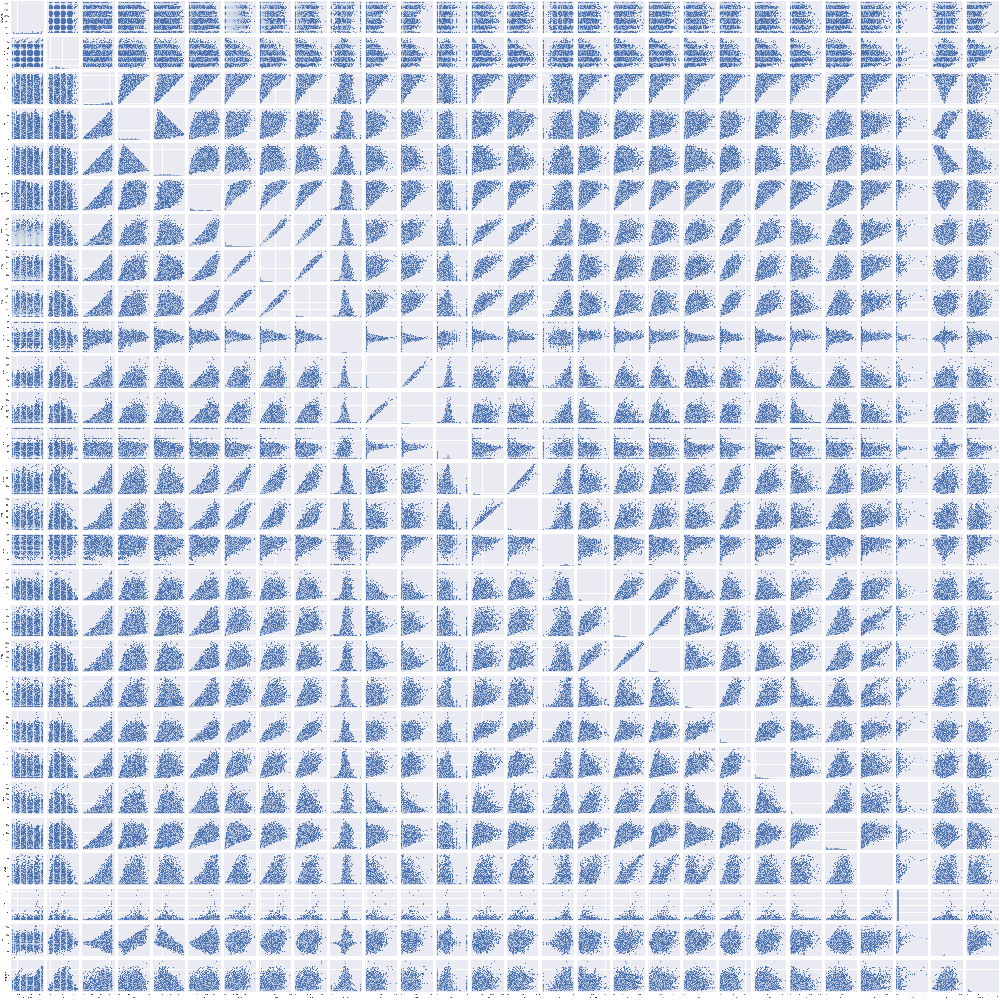

In [8]:
# View correlation among all variables using pairplot
sns.pairplot(nba)

<AxesSubplot:>

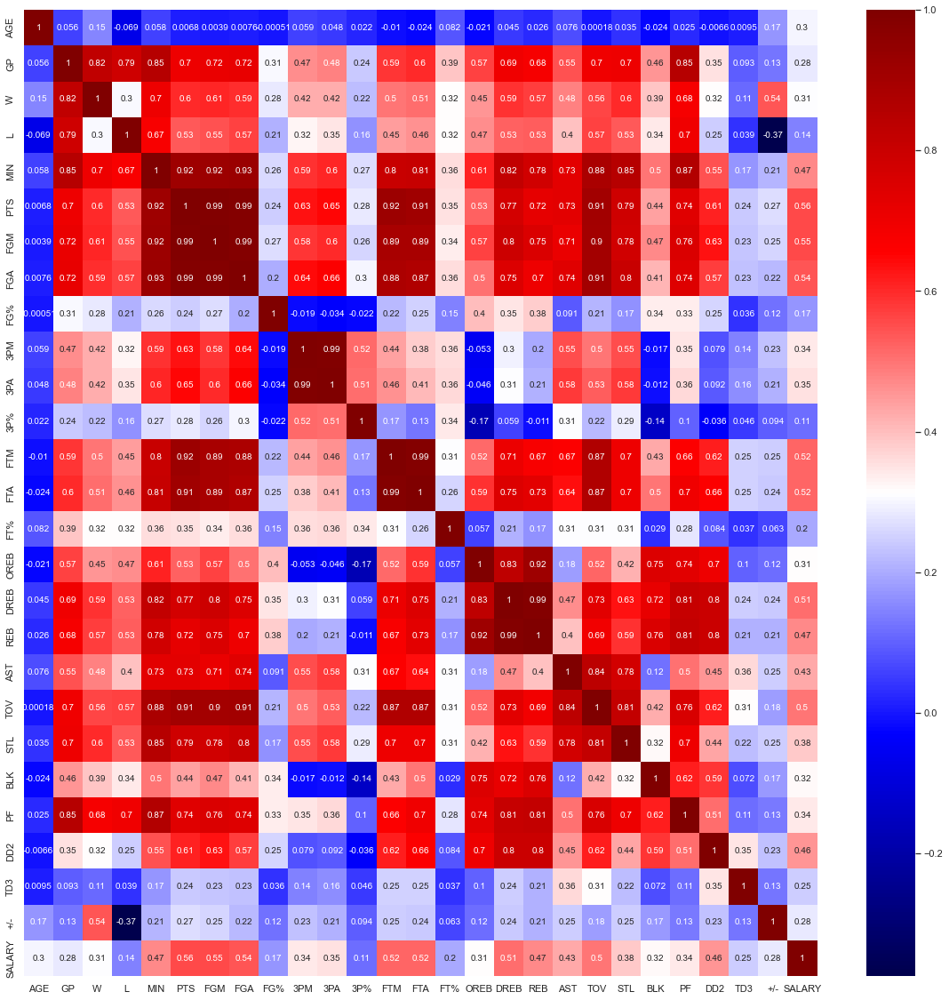

In [23]:
# View correlation among all variables using heatmap
fig, ax = plt.subplots(figsize=(20,20))


sns.heatmap(nba.corr(), cmap='seismic', annot=True)

In [24]:
# See correlation chart
nba.corr()

,AGE,GP,W,L,MIN,PTS,FGM,FGA,FG%,3PM,...,REB,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SALARY
AGE,1.000000,0.056444,0.150841,-0.068755,0.057657,0.006811,0.003869,0.007650,-0.000511,0.059188,...,0.026141,0.075927,0.000184,0.035044,-0.023700,0.025167,-0.006585,0.009513,0.168560,0.299378
GP,0.056444,1.000000,0.824939,0.789207,0.853988,0.704301,0.715170,0.719996,0.306624,0.465443,...,0.681114,0.547004,0.698800,0.703588,0.455239,0.852132,0.350632,0.093163,0.125193,0.283270
W,0.150841,0.824939,1.000000,0.303929,0.704592,0.600360,0.605897,0.594836,0.284153,0.423556,...,0.570533,0.482326,0.562229,0.599449,0.392541,0.679714,0.315925,0.109012,0.538896,0.309027
L,-0.068755,0.789207,0.303929,1.000000,0.673860,0.534810,0.547114,0.567266,0.208083,0.324311,...,0.528135,0.397929,0.566968,0.534598,0.340812,0.697762,0.247739,0.038585,-0.374507,0.141692
MIN,0.057657,0.853988,0.704592,0.673860,1.000000,0.916556,0.921649,0.926466,0.261708,0.587411,...,0.783540,0.731085,0.883298,0.853115,0.498547,0.865220,0.548250,0.172605,0.214848,0.469605
PTS,0.006811,0.704301,0.600360,0.534810,0.916556,1.000000,0.992940,0.989243,0.243464,0.630157,...,0.724003,0.729821,0.905554,0.789720,0.439778,0.739925,0.609671,0.240778,0.265100,0.558674
FGM,0.003869,0.715170,0.605897,0.547114,0.921649,0.992940,1.000000,0.988877,0.268499,0.581565,...,0.754480,0.713587,0.899718,0.784024,0.471717,0.757673,0.632502,0.232237,0.253782,0.554582
FGA,0.007650,0.719996,0.594836,0.567266,0.926466,0.989243,0.988877,1.000000,0.202045,0.641837,...,0.702832,0.740596,0.905115,0.804978,0.411998,0.743126,0.573833,0.228450,0.218776,0.538698
FG%,-0.000511,0.306624,0.284153,0.208083,0.261708,0.243464,0.268499,0.202045,1.000000,-0.018968,...,0.378335,0.091424,0.213810,0.166396,0.338265,0.334251,0.253729,0.035884,0.121242,0.170793
3PM,0.059188,0.465443,0.423556,0.324311,0.587411,0.630157,0.581565,0.641837,-0.018968,1.000000,...,0.197929,0.550128,0.498688,0.550183,-0.016941,0.348293,0.078709,0.141397,0.227386,0.340749


### View a Subset of Features

<AxesSubplot:>

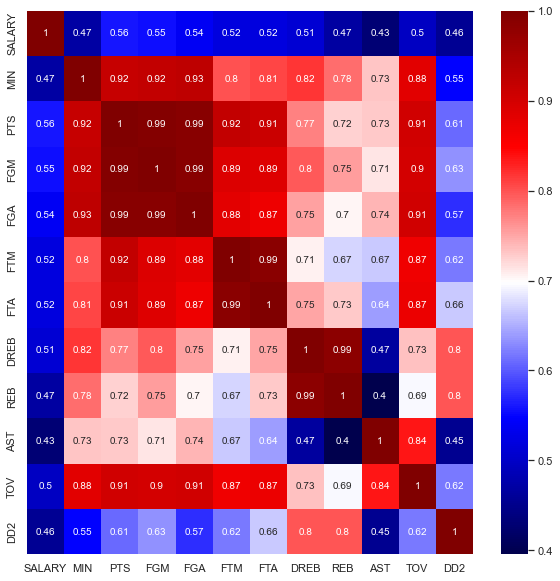

In [25]:
# Select a few variables with stronger correlation for closer inspection with heatmap
subset = nba[['SALARY','MIN', 'PTS', 'FGM', 'FGA', 'FTM', 'FTA', 
              'DREB', 'REB', 'AST', 'TOV', 'DD2']]
fig, ax = plt.subplots(figsize=(10,10))


sns.heatmap(subset.corr(), cmap='seismic', annot=True)

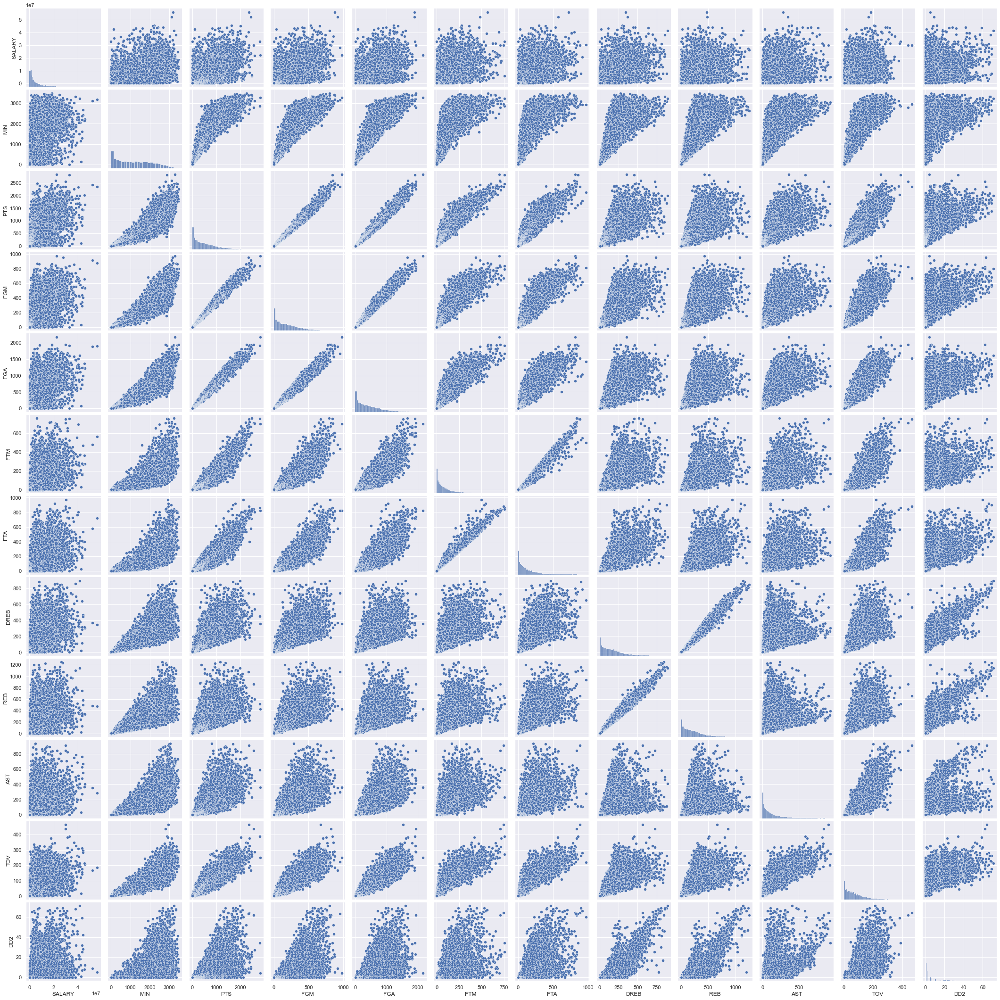

In [26]:
sns.pairplot(subset)

In [27]:
subset.corr()

,SALARY,MIN,PTS,FGM,FGA,FTM,FTA,DREB,REB,AST,TOV,DD2
SALARY,1.000000,0.469605,0.558674,0.554582,0.538698,0.520518,0.519706,0.511203,0.468560,0.428999,0.495411,0.456392
MIN,0.469605,1.000000,0.916556,0.921649,0.926466,0.801498,0.807241,0.817977,0.783540,0.731085,0.883298,0.548250
PTS,0.558674,0.916556,1.000000,0.992940,0.989243,0.921161,0.910632,0.771813,0.724003,0.729821,0.905554,0.609671
FGM,0.554582,0.921649,0.992940,1.000000,0.988877,0.889409,0.887467,0.795447,0.754480,0.713587,0.899718,0.632502
FGA,0.538698,0.926466,0.989243,0.988877,1.000000,0.880624,0.869243,0.752631,0.702832,0.740596,0.905115,0.573833
FTM,0.520518,0.801498,0.921161,0.889409,0.880624,1.000000,0.986441,0.706484,0.673182,0.665649,0.866726,0.618267
FTA,0.519706,0.807241,0.910632,0.887467,0.869243,0.986441,1.000000,0.750741,0.728777,0.639563,0.870733,0.664919
DREB,0.511203,0.817977,0.771813,0.795447,0.752631,0.706484,0.750741,1.000000,0.985124,0.466102,0.734100,0.798275
REB,0.468560,0.783540,0.724003,0.754480,0.702832,0.673182,0.728777,0.985124,1.000000,0.395570,0.693754,0.797990
AST,0.428999,0.731085,0.729821,0.713587,0.740596,0.665649,0.639563,0.466102,0.395570,1.000000,0.835041,0.453769


**Choose a few standout variables to see distribution plots**

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='SALARY', ylabel='Density'>

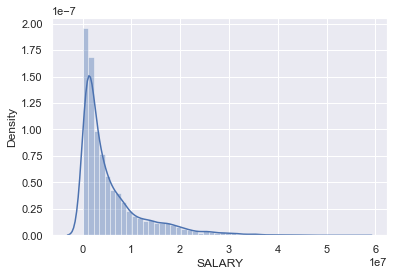

In [28]:
# Target
sns.distplot(nba['SALARY'])

**Our target shows a heavily right-skewed plot.  We may need to try a log transformation if our diagnostic plot shows normality issues.**

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='MIN', ylabel='Density'>

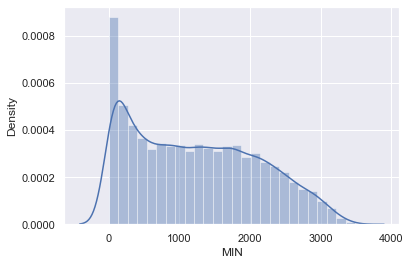

In [29]:
sns.distplot(nba['MIN'])

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='TOV', ylabel='Density'>

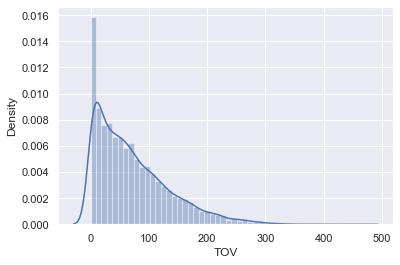

In [30]:
sns.distplot(nba['TOV'])

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='PTS', ylabel='Density'>

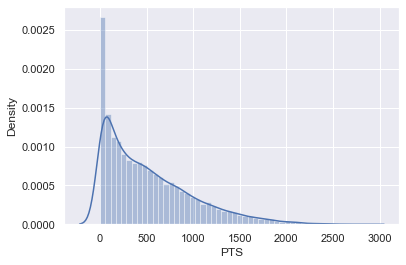

In [31]:
sns.distplot(nba['PTS'])

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='FG%', ylabel='Density'>

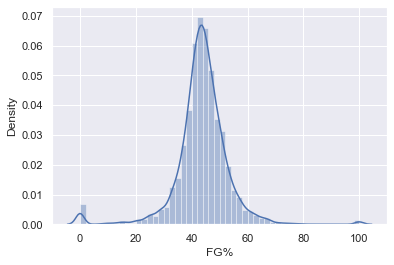

In [32]:
sns.distplot(nba['FG%'])

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='FT%', ylabel='Density'>

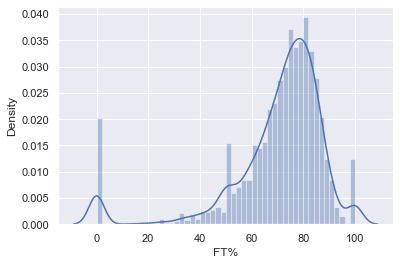

In [33]:
sns.distplot(nba['FT%'])

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='DD2', ylabel='Density'>

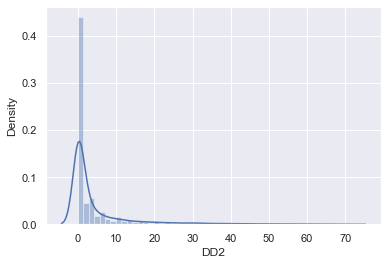

In [34]:
sns.distplot(nba['DD2'])

**Some of these features, including the target, appear highly skewed right or left.  Only FG% appears normally distributed in this subset. Although target and features are not required to be normally distributed, this may cause normality issues later in our modeling and cause poor performance.**

### VIF

In [9]:
# Check for multicollinearity with VIF between all variables

from statsmodels.stats.outliers_influence import variance_inflation_factor

variables = nba[['SEASON','AGE','GP', 'W','L','MIN', 'FGM', 'FG%', '3PM', 
                 '3PA', 'FTM', 'FTA','FT%', 'OREB', 'DREB','REB',
                 'AST','TOV','STL','BLK','PF','DD2','TD3','+/-']]
vif = pd.DataFrame()
vif['VIF'] = [variance_inflation_factor(variables.values, i) for i in range(variables.shape[1])]
vif['features'] = variables.columns

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\statsmodels\stats\outliers_influence.py:195: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)


In [10]:
vif

,VIF,features
0,74.672427,SEASON
1,43.765043,AGE
2,inf,GP
3,inf,W
4,inf,L
5,84.231282,MIN
6,35.414118,FGM
7,28.263294,FG%
8,109.989175,3PM
9,121.101199,3PA


In [37]:
# Remove variables with possible multicollinearity issues

variables2 = nba[['AGE','W','L','MIN', 'FGM', 'FG%', '3PM', 
                 '3PA', 'FTM', 'FTA','FT%', 'OREB','DREB',
                 'AST','TOV','STL','BLK','PF','DD2','TD3','+/-']]
vif2 = pd.DataFrame()
vif2['VIF'] = [variance_inflation_factor(variables2.values, i) for i in range(variables2.shape[1])]
vif2['features'] = variables2.columns

In [38]:
vif2

,VIF,features
0,19.799640,AGE
1,14.383564,W
2,20.284419,L
3,83.960372,MIN
4,35.413287,FGM
5,21.779680,FG%
6,108.614595,3PM
7,119.093729,3PA
8,115.012014,FTM
9,132.191011,FTA


**Generally, a VIF value in the range 1 to 5 is considered good.  Here we have most features with values much higher than 5. If we eliminated all the ones above VIF 5, then we would have almost no features left.  So let's leave this as is, and start modeling.**

# OLS Model

In [11]:
# Establish the target
y = nba['SALARY']

# Establish the feature set
X = nba.drop(columns=['SALARY', 'PLAYER'])

# Add a constant
X = sm.add_constant(X)

# Run an OLS model to see stats
model = sm.OLS(y, X)
fit = model.fit()
fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 SALARY   R-squared:                       0.510
Model:                            OLS   Adj. R-squared:                  0.509
Method:                 Least Squares   F-statistic:                     493.9
Date:                Sat, 06 Aug 2022   Prob (F-statistic):               0.00
Time:                        19:06:45   Log-Likelihood:            -1.9123e+05
No. Observations:               11397   AIC:                         3.825e+05
Df Residuals:                   11372   BIC:                         3.827e+05
Df Model:                          24                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -2.095e+08   1.42e+07    -14.702      0.000   -2.37e+08   -1.82e+08
SEASON       9.89e+04   7068.319     13.992      0.000     8.5e+04    1.13e+05
AGE          4.69e+05   1.08e+04     43.552      0.000    4.48e+05     4.9e+05
GP         -4.532e+04   2984.770    -15.185      0.000   -5.12e+04   -3.95e+04
W           -2.32e+04   4093.393     -5.667      0.000   -3.12e+04   -1.52e+04
L          -2.212e+04   4645.103     -4.763      0.000   -3.12e+04    -1.3e+04
MIN        -2614.0987    273.745     -9.549      0.000   -3150.686   -2077.512
PTS        -1866.6344   1217.903     -1.533      0.125   -4253.934     520.665
FGM          1.28e+04   3036.174      4.217      0.000    6852.057    1.88e+04
FGA         5312.2387   1480.053      3.589      0.000    2411.078    8213.399
FG%          1.84e+04   5514.654      3.336      0.001    7585.930    2.92e+04
3PM        -1.402e+04   7369.223     -1.903      0.057   -2.85e+04     423.512
3PA         1.105e+04   3271.352      3.379      0.001    4641.105    1.75e+04
3P%        -8659.4261   3134.964     -2.762      0.006   -1.48e+04   -2514.356
FTM        -1.345e+04   3218.532     -4.180      0.000   -1.98e+04   -7143.284
FTA         1.899e+04   2828.730      6.712      0.000    1.34e+04    2.45e+04
FT%          2.08e+04   2783.431      7.473      0.000    1.53e+04    2.63e+04
OREB       -4292.6431   1462.343     -2.935      0.003   -7159.087   -1426.199
DREB        1.207e+04   1112.830     10.849      0.000    9891.568    1.43e+04
REB         7780.2635    699.596     11.121      0.000    6408.934    9151.593
AST         1.202e+04    997.256     12.056      0.000    1.01e+04     1.4e+04
TOV        -4199.7026   2784.828     -1.508      0.132   -9658.446    1259.041
STL        -2.192e+04   2843.734     -7.707      0.000   -2.75e+04   -1.63e+04
BLK         1.917e+04   2188.343      8.760      0.000    1.49e+04    2.35e+04
PF         -5694.5575   1737.537     -3.277      0.001   -9100.429   -2288.686
DD2        -1.032e+05   1.18e+04     -8.767      0.000   -1.26e+05   -8.01e+04
TD3         2.102e+05   4.94e+04      4.253      0.000    1.13e+05    3.07e+05
+/-         2063.5824    472.387      4.368      0.000    1137.623    2989.542
==============================================================================
Omnibus:                     2890.346   Durbin-Watson:                   1.878
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            11589.146
Skew:                           1.208   Prob(JB):                         0.00
Kurtosis:                       7.309   Cond. No.                     1.04e+16
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 7.07e-22. This might indicate

In [12]:
r_squared = fit.rsquared
adj_r_squared = fit.rsquared_adj

print('r_sq =', np.round(r_squared, 3))
print('adj_r_sq =', np.round(adj_r_squared,3))

r_sq = 0.51
adj_r_sq = 0.509


In [41]:
# Drop variables with high p-values (> 0.05) - PTS, FGA, 3P% - and run OLS model again

X2 = nba.drop(columns=['SALARY', 'PLAYER', 'SEASON', 'PTS', 'FGA', '3P%'])
X2 = sm.add_constant(X2)

model2 = sm.OLS(y, X2)
fit2 = model2.fit()
fit2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 SALARY   R-squared:                       0.502
Model:                            OLS   Adj. R-squared:                  0.501
Method:                 Least Squares   F-statistic:                     545.7
Date:                Sat, 06 Aug 2022   Prob (F-statistic):               0.00
Time:                        13:10:02   Log-Likelihood:            -1.9133e+05
No. Observations:               11397   AIC:                         3.827e+05
Df Residuals:                   11375   BIC:                         3.829e+05
Df Model:                          21                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -1.024e+07   3.84e+05    -26.684      0.000    -1.1e+07   -9.49e+06
AGE         4.467e+05   1.07e+04     41.684      0.000    4.26e+05    4.68e+05
GP         -4.723e+04   2994.936    -15.770      0.000   -5.31e+04   -4.14e+04
W           -2.22e+04   4122.902     -5.384      0.000   -3.03e+04   -1.41e+04
L          -2.503e+04   4678.467     -5.350      0.000   -3.42e+04   -1.59e+04
MIN        -3157.5529    266.603    -11.844      0.000   -3680.142   -2634.964
FGM         2.081e+04   1022.127     20.362      0.000    1.88e+04    2.28e+04
FG%         2.122e+04   5257.855      4.037      0.000    1.09e+04    3.15e+04
3PM        -3.885e+04   7443.121     -5.220      0.000   -5.34e+04   -2.43e+04
3PA         2.294e+04   2889.320      7.940      0.000    1.73e+04    2.86e+04
FTM        -1.302e+04   3406.536     -3.823      0.000   -1.97e+04   -6345.233
FTA         1.681e+04   2820.391      5.961      0.000    1.13e+04    2.23e+04
FT%         2.024e+04   2767.522      7.314      0.000    1.48e+04    2.57e+04
OREB       -5162.4336   1458.592     -3.539      0.000   -8021.525   -2303.342
DREB        1.441e+04   1102.013     13.072      0.000    1.22e+04    1.66e+04
REB         9243.2110    687.826     13.438      0.000    7894.954    1.06e+04
AST         1.435e+04    985.420     14.559      0.000    1.24e+04    1.63e+04
TOV        -8507.8046   2750.131     -3.094      0.002   -1.39e+04   -3117.074
STL        -2.443e+04   2851.758     -8.567      0.000      -3e+04   -1.88e+04
BLK         2.021e+04   2199.598      9.190      0.000    1.59e+04    2.45e+04
PF         -7185.0795   1744.427     -4.119      0.000   -1.06e+04   -3765.702
DD2        -1.266e+05   1.17e+04    -10.790      0.000    -1.5e+05   -1.04e+05
TD3         1.917e+05   4.98e+04      3.848      0.000     9.4e+04    2.89e+05
+/-         1346.6457    467.381      2.881      0.004     430.498    2262.794
==============================================================================
Omnibus:                     3043.730   Durbin-Watson:                   1.876
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            12698.881
Skew:                           1.261   Prob(JB):                         0.00
Kurtosis:                       7.514   Cond. No.                     3.06e+17
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 3.21e-25. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [42]:
r_squared2 = fit2.rsquared
adj_r_squared2 = fit2.rsquared_adj

print('r_sq =', np.round(r_squared2, 3))
print('adj_r_sq =', np.round(adj_r_squared2,3))

r_sq = 0.502
adj_r_sq = 0.501


**The r_squared values and adjusted_r_squared values are exactly the same before and after removing some variables.**

**It is obvious that some features have multicollinearity which may cause major issues with our regression, we can try to drop those before running an OLS model to compare.**

In [13]:
# Drop columns L (Losses), FGM (Field Goals Made), FGA (Field Goals Attempted), 3PM (3 Point Field Goals Made), 3PA (3 Point Field Goals Attempted), FTM (Free Throws Made), FTA (Free Throws Attempted), OREB (Offensive Rebounds), DREB (Defensive Rebounds)

nba_2 = nba.drop(['GP', 'FGM','FGA', '3PM', '3PA', 'FTM', 
                  'FTA', 'REB'], axis=1)

y = nba_2['SALARY']
X3 = nba_2.drop(columns=['SALARY', 'PLAYER'])
X3 = sm.add_constant(X3)

model3 = sm.OLS(y, X3)
fit3 = model3.fit()
fit3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 SALARY   R-squared:                       0.506
Model:                            OLS   Adj. R-squared:                  0.505
Method:                 Least Squares   F-statistic:                     613.4
Date:                Sat, 06 Aug 2022   Prob (F-statistic):               0.00
Time:                        19:07:22   Log-Likelihood:            -1.9128e+05
No. Observations:               11397   AIC:                         3.826e+05
Df Residuals:                   11377   BIC:                         3.827e+05
Df Model:                          19                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -2.166e+08   1.33e+07    -16.269      0.000   -2.43e+08   -1.91e+08
SEASON      1.029e+05   6607.725     15.565      0.000    8.99e+04    1.16e+05
AGE         4.636e+05   1.08e+04     42.960      0.000    4.42e+05    4.85e+05
W          -6.465e+04   5448.994    -11.864      0.000   -7.53e+04    -5.4e+04
L          -6.384e+04   6639.060     -9.616      0.000   -7.69e+04   -5.08e+04
MIN        -2250.3807    262.630     -8.569      0.000   -2765.180   -1735.581
PTS         9140.7497    343.054     26.645      0.000    8468.305    9813.195
FG%         8672.5411   5119.029      1.694      0.090   -1361.639    1.87e+04
3P%        -7965.4507   3072.868     -2.592      0.010    -1.4e+04   -1942.100
FT%         1.662e+04   2676.320      6.210      0.000    1.14e+04    2.19e+04
OREB        2237.2995   1868.540      1.197      0.231   -1425.362    5899.961
DREB        1.999e+04   1145.462     17.455      0.000    1.77e+04    2.22e+04
AST         1.099e+04    987.874     11.129      0.000    9057.534    1.29e+04
TOV         -170.5925   2625.287     -0.065      0.948   -5316.609    4975.424
STL        -1.735e+04   2800.359     -6.195      0.000   -2.28e+04   -1.19e+04
BLK         2.041e+04   2165.389      9.425      0.000    1.62e+04    2.47e+04
PF         -6981.0950   1738.298     -4.016      0.000   -1.04e+04   -3573.730
DD2        -1.051e+05   1.16e+04     -9.055      0.000   -1.28e+05   -8.23e+04
TD3         2.484e+05   4.93e+04      5.043      0.000    1.52e+05    3.45e+05
+/-         1569.9681    458.865      3.421      0.001     670.514    2469.422
==============================================================================
Omnibus:                     2933.153   Durbin-Watson:                   1.870
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            11809.142
Skew:                           1.225   Prob(JB):                         0.00
Kurtosis:                       7.344   Cond. No.                     7.56e+05
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 7.56e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [44]:
r_squared3 = fit3.rsquared
adj_r_squared3 = fit3.rsquared_adj

print('r_sq =', np.round(r_squared3, 3))
print('adj_r_sq =', np.round(adj_r_squared3,3))

r_sq = 0.496
adj_r_sq = 0.495


**Looks like we get a lower Adj. R-Squared.  We'll keep all the variables like in the model2.**

# Model Selection

## Simple Linear Regression Model with Scikit-Learn

In [14]:
# Before partitioning dataset, sort data in ascending order by date
nba_sorted = nba.sort_values('SEASON', ascending=True).reset_index(drop=True)
nba_sorted.head()

,SEASON,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,...,REB,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SALARY
0,1996,James Scott,25,8,8,0,32,1,0,8,...,6,3,2,2,0,5,0,0,-12,381449.0
1,1996,Matt Maloney,25,82,57,25,2387,767,271,615,...,160,303,122,82,1,125,2,0,326,429130.0
2,1996,Sam Mitchell,33,82,40,42,2051,766,269,603,...,326,79,93,51,20,232,2,0,-196,2080633.0
3,1996,Sherman Douglas,30,79,33,46,2314,764,306,610,...,193,427,153,78,10,191,2,0,-120,6231496.0
4,1996,Nick Anderson,29,63,39,24,2164,757,288,725,...,304,182,86,120,32,160,2,0,163,6571332.0


### Partition Dataset

#### Train and Test Sets

In [15]:
# IMPORTANT TO HOLD MOST RECENT DATA FOR TEST SET
test_set = nba_sorted.iloc[9117:, :] # 20% of dataset
train_set = nba_sorted.iloc[:9117, :] # 80% of dataset

In [16]:
# Partition dataset into train, val, test (60, 20, 20 divide)

# Split train_set into train and val sets

y = train_set['SALARY']
X = train_set.drop(columns=['SALARY', 'PLAYER'])

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=0)

### Simple Linear Regression

In [17]:
# Fit a simple linear regression

lr = LinearRegression()
model = lr.fit(X_train, y_train)

model.score(X_train, y_train)

print('simple_r_sq =', np.round(model.score(X_train, y_train), 3)) 

simple_r_sq = 0.504


In [18]:
# Score validation set
model.score(X_val, y_val)

print('simple_r_sq_val =', np.round(model.score(X_val,y_val), 3))

simple_r_sq_val = 0.525


**The val score is higher than the train score, could be an indication that it is underfit or has outliers.  We could try regularization and see if score improves.**

In [57]:
# Feature coefficient results
list(zip(X_train.columns, lr.coef_))

[('AGE', 408566.09786033636),
 ('GP', -40318.09198366624),
 ('W', -15271.638317410956),
 ('L', -25046.453666259822),
 ('MIN', -1582.7561742280532),
 ('PTS', -3606.055343048578),
 ('FGM', 12040.270876939147),
 ('FGA', 6631.739196392856),
 ('FG%', 24288.102786932912),
 ('3PM', -12060.50877630834),
 ('3PA', 8652.578976687357),
 ('3P%', -4616.791222734961),
 ('FTM', -15626.088320618843),
 ('FTA', 22220.838526903564),
 ('FT%', 16534.79106890442),
 ('OREB', -7528.698447154281),
 ('DREB', 13423.424156493851),
 ('REB', 5894.725709339553),
 ('AST', 9330.278731796607),
 ('TOV', -8763.601716084102),
 ('STL', -22765.0384203926),
 ('BLK', 16820.208981360927),
 ('PF', -8331.92097821614),
 ('DD2', -94033.26178428213),
 ('TD3', 55818.70408789165),
 ('+/-', 1714.1296777289256)]

### Diagnostic Plots

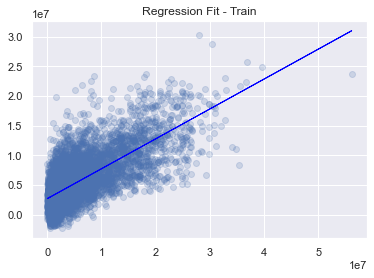

In [19]:
# Fitted vs actual
fit = lr.fit(X_train, y_train)

y_train_pred_simple = fit.predict(X_train)

# Prepare X and y from given data
X_simple = y_train
y_simple = y_train_pred_simple

# Calculate parameters (intercept = theta[1] and slope = theta[0]) 
# of line using np.polyfit() function
theta = np.polyfit(X_simple,y_simple,1)

# Calculate y-axis values against x-values 
# according to parameters theta0, theta1 and theta2
y_line = theta[1] + theta[0] * X_simple


# Plot the data points and best fit line
plt.scatter(y_train, y_train_pred_simple, alpha=0.2)


plt.title("Regression Fit - Train")

# Line of best fit
plt.plot(X_simple, y_line, color='blue', linewidth=1)

Text(0.5, 1.0, 'Residuals vs Predictions')

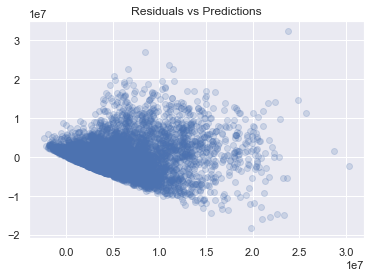

In [20]:
# Plot residuals vs predicted
resid_simple = y_train - y_train_pred_simple

plt.scatter(y_train_pred_simple, resid_simple, alpha=0.2)
plt.plot([0,200], [0,0])
plt.title("Residuals vs Predictions")

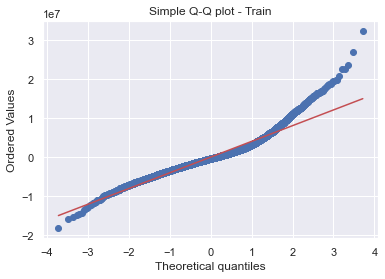

In [21]:
# Plot a normal q-q plto
stats.probplot(resid_simple, dist="norm", plot=plt)
plt.title("Simple Q-Q plot - Train")
plt.show()


### RidgeCV

**Standardize the scale for regularization regression.**

In [22]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)

# Apply the same scaler to the val set
X_val_scaled = scaler.transform(X_val)

In [23]:
# Fit a Ridge model
alphas = 10**np.linspace(-3,10, 200)

ridge = RidgeCV(alphas=alphas, cv=5)
ridge.fit(X_train_scaled, y_train)
ridge.score(X_train_scaled, y_train)
print('ridge_r_sq =', np.round(ridge.score(X_train_scaled, y_train), 3))

ridge_r_sq = 0.504


In [24]:
# View alpha
ridge.fit(X_train_scaled, y_train).alpha_

11.226677735108137

In [25]:
# Score on validation set
ridge.score(X_val_scaled, y_val)
print('ridge_r_sq_val =', np.round(ridge.score(X_val_scaled, y_val), 3))

ridge_r_sq_val = 0.525


In [66]:
# Feature coefficient results
list(zip(X_train.columns, ridge.coef_))

[('AGE', 1770371.2129865799),
 ('GP', -636527.4406335879),
 ('W', -447227.13898573065),
 ('L', -559726.4812591302),
 ('MIN', -1278674.3638321115),
 ('PTS', 241521.26557798995),
 ('FGM', 917940.7095038836),
 ('FGA', 2076911.9374803987),
 ('FG%', 212593.39222697774),
 ('3PM', -703727.476024656),
 ('3PA', 1028780.3141671304),
 ('3P%', -85197.41527155359),
 ('FTM', -1595529.218088525),
 ('FTA', 2491183.7214915543),
 ('FT%', 273835.19276913174),
 ('OREB', -452911.0141337434),
 ('DREB', 1810514.92674872),
 ('REB', 1163163.987938275),
 ('AST', 1176831.5276846853),
 ('TOV', -460052.9661202945),
 ('STL', -782667.9063798137),
 ('BLK', 603547.7905858619),
 ('PF', -627358.2070382811),
 ('DD2', -818444.1490373727),
 ('TD3', 42966.60674665627),
 ('+/-', 296960.6763426212)]

**Interestingly, the train and val scores for the Ridge Regression model are exactly the same as those in the simple linear regression model.  However, the regularization parameter alpha = 13 tells us that the Ridge model didn't run as a SLR where alpha=0.**

**Let's try a Lasso model to try to simplify our model with feature selection.**

### LassoCV

In [26]:
# Fit a LASSO model 

lasso = LassoCV(cv=5)
lasso.fit(X_train_scaled, y_train)
r_sq_lasso = lasso.score(X_train_scaled, y_train)
print('r_sq_lasso = ', np.round(r_sq_lasso, 3))

r_sq_lasso =  0.504


In [27]:
# Score on validation set
print('r_sq_lasso_val = ', np.round(lasso.score(X_val_scaled, y_val), 3))

r_sq_lasso_val =  0.525


In [28]:
# View the alpha
lasso.fit(X_train_scaled, y_train).alpha_

4075.8508668026075

In [29]:
# Feature coefficient results
list(zip(X_train.columns, lasso.coef_))

[('SEASON', 579092.3845213321),
 ('AGE', 1833365.337829397),
 ('GP', -1385826.0360591053),
 ('W', -0.0),
 ('L', -150731.98677729155),
 ('MIN', -881639.6824095738),
 ('PTS', -0.0),
 ('FGM', -0.0),
 ('FGA', 3030798.1921848604),
 ('FG%', 176819.44200027644),
 ('3PM', -0.0),
 ('3PA', 102940.33060573798),
 ('3P%', -99932.59235515233),
 ('FTM', -1624521.0437068006),
 ('FTA', 2621364.073585346),
 ('FT%', 260619.86847209572),
 ('OREB', -26031.00441619693),
 ('DREB', 2164263.6188859376),
 ('REB', 0.0),
 ('AST', 961197.729059979),
 ('TOV', -252589.51292574996),
 ('STL', -713378.9980528979),
 ('BLK', 572070.2379627003),
 ('PF', -491276.983467439),
 ('DD2', -653575.725312484),
 ('TD3', 51681.98673021694),
 ('+/-', 355994.22285788436)]

**LassoCV zeroed out some variables.  Let's run another LassoCV model after removing those variables.**

In [30]:
# Remove variables and Fit a LASSO model 
y = train_set['SALARY']
X = train_set.drop(columns=['SALARY', 'PLAYER','W', 'PTS', 'FGM','3PM','REB'])

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=0)

scaler = StandardScaler()
X_train_scaled2 = scaler.fit_transform(X_train)

# Apply the same scaler to the val set
X_val_scaled2 = scaler.transform(X_val)

lasso2 = LassoCV()
lasso2.fit(X_train_scaled2, y_train)
r_sq_lasso2 = lasso2.score(X_train_scaled2, y_train)
print('lasso2_r_sq = ', np.round(r_sq_lasso2, 3))

lasso2_r_sq =  0.504


In [31]:
# Score on validation set
print('lasso2_r_sq_val = ', np.round(lasso2.score(X_val_scaled2, y_val), 3))

lasso2_r_sq_val =  0.525


In [32]:
# Feature coefficient results
list(zip(X_train.columns, lasso2.coef_))

[('SEASON', 577228.8261033905),
 ('AGE', 1834098.0372316844),
 ('GP', -1391059.8580410287),
 ('L', -149404.38330104356),
 ('MIN', -927769.0620129129),
 ('FGA', 3069000.1915469496),
 ('FG%', 177013.6418500153),
 ('3PA', 105322.73442757128),
 ('3P%', -101123.62087367606),
 ('FTM', -1747098.9103044933),
 ('FTA', 2749904.313393683),
 ('FT%', 268068.3667076784),
 ('OREB', -30382.47165522756),
 ('DREB', 2195878.1992025054),
 ('AST', 992256.1308654734),
 ('TOV', -283743.9688922244),
 ('STL', -719590.6952116772),
 ('BLK', 572329.3592419741),
 ('PF', -486126.63176803646),
 ('DD2', -676361.5841031218),
 ('TD3', 50818.67450861822),
 ('+/-', 354956.7057891941)]

**Interestingly enough again, we get the same scores before and after removing variables.**

# Feature Engineering

**Let's see if some feature engineering will help improve the score.  We'll do a polynomial transformation to see how variable interactions affect the model.**

### Polynomial Transformation

In [33]:
# Hold more recent data for test set
test_set = nba_sorted.iloc[9117:, :] # 20% of dataset
train_set = nba_sorted.iloc[:9117, :] # 80% of dataset

from sklearn.preprocessing import PolynomialFeatures

y = train_set['SALARY']
X = train_set.drop(columns=['SALARY', 'PLAYER'])

#Partition train set into train and val
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=0)

In [34]:
# Create polynomial features
poly = PolynomialFeatures(degree=2)
X_train_poly = poly.fit_transform(X_train)

# Apply polynomial transformation to val set
X_val_poly = poly.transform(X_val)

### Polynomial Transformation + Simple Linear Regression

In [35]:
# Fit a model using polynomial features
lr_poly = LinearRegression()
lr_poly.fit(X_train_poly, y_train)
lr_poly.score(X_train_poly, y_train)
print('poly_r_sq = ', np.round(lr_poly.score(X_train_poly, y_train),3))

poly_r_sq =  0.637


In [36]:
# Score on validation set
lr_poly.score(X_val_poly, y_val)
print('poly_r_sq_val =', np.round(lr_poly.score(X_val_poly, y_val),3))

poly_r_sq_val = 0.493


**Training score improved but not val score.**

In [78]:
# Feature coefficient results
list(zip(poly.get_feature_names(X_train.columns), lr_poly.coef_))

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


[('1', 0.0006950689629975807),
 ('AGE', 1621933.5830468338),
 ('GP', 147116.75651685704),
 ('W', 42257.84736425592),
 ('L', 104858.9145510574),
 ('MIN', 6766.338676931592),
 ('PTS', -285358.2014912699),
 ('FGM', 396640.65626739606),
 ('FGA', 63189.3008093803),
 ('FG%', 71237.73639933136),
 ('3PM', -986481.1339709099),
 ('3PA', -59165.85747321059),
 ('3P%', 20382.27676758884),
 ('FTM', -92158.3759859182),
 ('FTA', -195226.11930785867),
 ('FT%', -55130.869508883225),
 ('OREB', -23044.313522520442),
 ('DREB', 7699.65905259544),
 ('REB', -15344.653819863668),
 ('AST', -77878.63352922809),
 ('TOV', 136329.04222180473),
 ('STL', 108402.48061150585),
 ('BLK', 130048.97033454943),
 ('PF', -70307.16783002813),
 ('DD2', -458717.2868996996),
 ('TD3', 17862080.123709846),
 ('+/-', 2005.23044030118),
 ('AGE^2', -24159.738337345672),
 ('AGE GP', -4855.867226701372),
 ('AGE W', -2638.876456094299),
 ('AGE L', -2216.9902290799832),
 ('AGE MIN', -75.3097687888876),
 ('AGE PTS', 45.64037217206351),
 ('A

### Diagnostic Plots

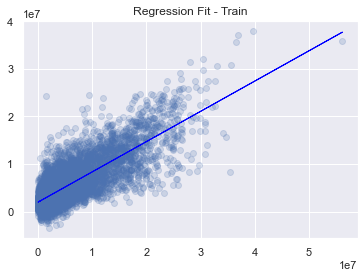

In [37]:
# Fitted vs actual
fit = lr_poly.fit(X_train_poly, y_train)

y_train_pred_simple_poly = fit.predict(X_train_poly)

# Prepare X and y from given data
X_simple_poly = y_train
y_simple_poly = y_train_pred_simple_poly

# Calculate parameters (intercept = theta[1] and slope = theta[0]) 
# of line using np.polyfit() function
theta = np.polyfit(X_simple_poly,y_simple_poly,1)

# Calculate y-axis values against x-values 
# according to parameters theta0, theta1 and theta2
y_line = theta[1] + theta[0] * X_simple_poly


# Plot the data points and best fit line
plt.scatter(y_train, y_train_pred_simple_poly, alpha=0.2)


plt.title("Regression Fit - Train")

# Line of best fit
plt.plot(X_simple_poly, y_line, color='blue', linewidth=1)

Text(0.5, 1.0, 'Residuals vs Predictions')

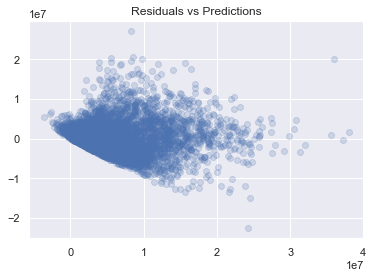

In [38]:
# Plot residuals vs predicted
resid_train_simple_poly = y_train - y_train_pred_simple_poly

plt.scatter(y_train_pred_simple_poly, resid_train_simple_poly, alpha=0.2)
plt.plot([0,200], [0,0])
plt.title("Residuals vs Predictions")

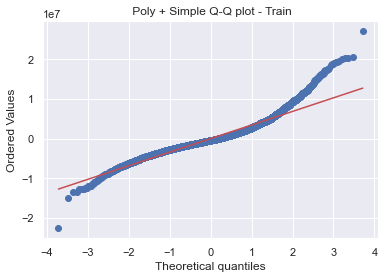

In [39]:
# Plot a normal q-q plot
stats.probplot(resid_train_simple_poly, dist="norm", plot=plt)
plt.title(" Poly + Simple Q-Q plot - Train")
plt.show()

### Polynomial Transformation + RidgeCV

In [41]:
scaler = StandardScaler()
X_train_poly_scaled = scaler.fit_transform(X_train_poly)

# Apply the same scaler to the val set
X_val_poly_scaled = scaler.transform(X_val_poly)

# Fit a Ridge model using polynomial features
ridge_poly = RidgeCV()
ridge_poly.fit(X_train_poly_scaled, y_train)
ridge_poly.score(X_train_poly_scaled, y_train)
print('poly_plus_ridge_r_sq = ', np.round(ridge_poly.score(X_train_poly_scaled, y_train),3))

poly_plus_ridge_r_sq =  0.617


In [42]:
# Score on validation set
ridge_poly.score(X_val_poly_scaled, y_val)
print('poly_plus_ridge_r_sq_val = ', np.round(ridge_poly.score(X_val_poly_scaled, y_val),3))

poly_plus_ridge_r_sq_val =  0.514


In [43]:
# Feature coefficient results
list(zip(poly.get_feature_names(X_train.columns), ridge_poly.coef_))

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


[('1', 0.0),
 ('SEASON', 375057.3765568407),
 ('AGE', 2477602.332746042),
 ('GP', 450810.94785443693),
 ('W', 409020.5146511048),
 ('L', 296462.412494611),
 ('MIN', 1571.7918167915195),
 ('PTS', -315453.8736079),
 ('FGM', -237481.2858466413),
 ('FGA', 133086.6120434776),
 ('FG%', -54822.737009804696),
 ('3PM', -252854.80826371256),
 ('3PA', -999722.9148125132),
 ('3P%', -5011.9508654829115),
 ('FTM', -508362.7046813732),
 ('FTA', -534318.9712285968),
 ('FT%', -263509.22287632944),
 ('OREB', -1176148.4490495715),
 ('DREB', 165331.11346940324),
 ('REB', -251333.25023301877),
 ('AST', -215894.85725421458),
 ('TOV', 103559.38814255409),
 ('STL', -658144.586910936),
 ('BLK', 116103.19331723824),
 ('PF', 221825.91803068016),
 ('DD2', -714386.6226191334),
 ('TD3', 1039293.2173182275),
 ('+/-', -609365.4263956118),
 ('SEASON^2', 152805.76987442654),
 ('SEASON AGE', 2887883.434180105),
 ('SEASON GP', 910394.5638417341),
 ('SEASON W', 842818.2125329226),
 ('SEASON L', 580579.6817254573),
 ('SEAS

**Try a LassoCV to get a model that minimizes errors while keeping the model as simple as possible.**

### Polynomial Transformation + LassoCV

**Standardize the scale for data for regularized regression**

In [44]:
# Fit a LASSO model using polynomial features
lasso_poly = LassoCV()
lasso_poly.fit(X_train_poly_scaled, y_train)
lasso_poly.score(X_train_poly_scaled, y_train)
print('poly_plus_lasso_r_sq = ', np.round(lasso_poly.score(X_train_poly_scaled, y_train),3))

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22673361624080.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22848707913376.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24805333128256.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 60658822687632.0, tolerance: 18586534817883.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 82780429305072.0, tolerance: 18586534817883.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27383116198304.0, tolerance: 18586534817883.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73906106344992.0, tolerance: 18890652957718.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 83956154480784.0, tolerance: 18890652957718.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 104187067639008.0, tolerance: 18890652957718.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklear

poly_plus_lasso_r_sq =  0.599


C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.838e+15, tolerance: 2.391e+13
  model = cd_fast.enet_coordinate_descent(


In [150]:
# Score on validation set
lasso_poly.score(X_val_poly_scaled, y_val)
print('poly_plus_lasso_r_sq_val = ', np.round(lasso_poly.score(X_val_poly_scaled, y_val),3))

poly_plus_lasso_r_sq_val =  0.564


In [87]:
# View the alpha
lasso_poly.fit(X_train_poly_scaled, y_train).alpha_

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19648981070496.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24466179406480.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31404306763632.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 70971575903568.0, tolerance: 19372825921187.926
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 67522082288672.0, tolerance: 19372825921187.926
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 222540267392016.0, tolerance: 19372825921187.926
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklear

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 134303525056608.0, tolerance: 18890652957718.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 131631037623856.0, tolerance: 18890652957718.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 121340262133136.0, tolerance: 18890652957718.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\skle

6913.059908807772

In [84]:
# Feature coefficient results
list(zip(poly.get_feature_names(X_train.columns), lasso_poly.coef_))

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


[('1', 0.0),
 ('AGE', 4652121.259354835),
 ('GP', 1374899.626939876),
 ('W', 0.0),
 ('L', 0.0),
 ('MIN', 0.0),
 ('PTS', 0.0),
 ('FGM', 0.0),
 ('FGA', 0.0),
 ('FG%', 0.0),
 ('3PM', -0.0),
 ('3PA', 0.0),
 ('3P%', 0.0),
 ('FTM', 0.0),
 ('FTA', 0.0),
 ('FT%', 0.0),
 ('OREB', -0.0),
 ('DREB', 1778889.067834226),
 ('REB', 0.0),
 ('AST', 249883.9544556066),
 ('TOV', 385400.35394392314),
 ('STL', -0.0),
 ('BLK', -0.0),
 ('PF', 0.0),
 ('DD2', -0.0),
 ('TD3', 76575.59702801514),
 ('+/-', -0.0),
 ('AGE^2', -3791669.5651088287),
 ('AGE GP', -2348930.475960305),
 ('AGE W', -0.0),
 ('AGE L', -0.0),
 ('AGE MIN', -0.0),
 ('AGE PTS', 4147679.7683763555),
 ('AGE FGM', 1302595.3735416392),
 ('AGE FGA', 358498.25225134497),
 ('AGE FG%', 155599.3874868964),
 ('AGE 3PM', 0.0),
 ('AGE 3PA', 20252.53344065847),
 ('AGE 3P%', -68288.4470544515),
 ('AGE FTM', 0.0),
 ('AGE FTA', 743900.1715433818),
 ('AGE FT%', 303290.19685764366),
 ('AGE OREB', -0.0),
 ('AGE DREB', 646321.6789401394),
 ('AGE REB', 0.0),
 ('AGE A

In [85]:
# Compare the scores on all the models
print('simple_r_sq =', np.round(model.score(X_train, y_train), 3)) 
print('simple_r_sq_val =', np.round(model.score(X_val,y_val), 3))
print('\n')
print('ridge_r_sq =', np.round(ridge.score(X_train_scaled, y_train), 3))
print('ridge_r_sq_val =', np.round(ridge.score(X_val_scaled, y_val), 3))
print('\n')
print('r_sq_lasso = ', np.round(r_sq_lasso, 3))
print('r_sq_lasso_val = ', np.round(lasso.score(X_val_scaled, y_val), 3))
print('\n')
print('lasso2_r_sq = ', np.round(r_sq_lasso2, 3))
print('lasso2_r_sq_val = ', np.round(lasso2.score(X_val_scaled2, y_val), 3))
print('\n')
print('poly_r_sq = ', np.round(lr_poly.score(X_train_poly, y_train),3))
print('poly_r_sq_val =', np.round(lr_poly.score(X_val_poly, y_val),3))
print('\n')
print('poly_plus_ridge_r_sq = ', np.round(ridge_poly.score(X_train_poly_scaled, y_train),3))
print('poly_plus_ridge_r_sq_val = ', np.round(ridge_poly.score(X_val_poly_scaled, y_val),3))
print('\n')
print('poly_plus_lasso_r_sq = ', np.round(lasso_poly.score(X_train_poly_scaled, y_train),3))
print('poly_plus_lasso_r_sq_val = ', np.round(lasso_poly.score(X_val_poly_scaled, y_val),3))

simple_r_sq = 0.497
simple_r_sq_val = 0.517


ridge_r_sq = 0.497
ridge_r_sq_val = 0.517


r_sq_lasso =  0.496
r_sq_lasso_val =  0.517


lasso2_r_sq =  0.496
lasso2_r_sq_val =  0.517


poly_r_sq =  0.62
poly_r_sq_val = 0.446


poly_plus_ridge_r_sq =  0.609
poly_plus_ridge_r_sq_val =  0.504


poly_plus_lasso_r_sq =  0.592
poly_plus_lasso_r_sq_val =  0.564


#### Best Score: 

**Although adding polynomial features + LASSO model gives us the best validation score, it also added some element of overfitting to our model.  We can try to counteract this by finding a range of alphas in order to discover the optimal alpha.**

### Polynomial Transformation + LassoCV - Tuning Lambda

In [147]:
# Fit a LASSO model using polynomial features, tuning lamba

lasso_poly2 = LassoCV(alphas=np.arange(5000, 9000, 100))
lasso_poly2.fit(X_train_poly_scaled, y_train)
lasso_poly2.score(X_train_poly_scaled, y_train)
print('poly_plus_lasso_r_sq_2 = ', np.round(lasso_poly2.score(X_train_poly_scaled, y_train),3))

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2436539002416744.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 283923171969024.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 216555682929376.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\skl

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28219380967712.0, tolerance: 18586534817883.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28486440255024.0, tolerance: 18586534817883.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22602088557696.0, tolerance: 18586534817883.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn

poly_plus_lasso_r_sq_2 =  0.589


C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.249e+15, tolerance: 2.391e+13
  model = cd_fast.enet_coordinate_descent(


In [144]:
# Score on the validation set
lasso_poly2.score(X_val_poly_scaled, y_val)
print('poly_plus_lasso_r_sq_val_2 = ', np.round(lasso_poly2.score(X_val_poly_scaled, y_val),3))

poly_plus_lasso_r_sq_val_2 =  0.565


In [138]:
# View the optimal lambda
lasso_poly2.fit(X_train_poly_scaled, y_train).alpha_

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2436539002416744.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 283923171969024.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 216555682929376.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\skl

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1315451377114432.0, tolerance: 18890652957718.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 171435126544432.0, tolerance: 18890652957718.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 128236901102576.0, tolerance: 18890652957718.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\skl

8900

**We will use this optimal lambda value in our final model run.**

In [153]:
# Compare the scores on all the models
print('simple_r_sq =', np.round(model.score(X_train, y_train), 3)) 
print('simple_r_sq_val =', np.round(model.score(X_val,y_val), 3))
print('\n')
print('ridge_r_sq =', np.round(ridge.score(X_train_scaled, y_train), 3))
print('ridge_r_sq_val =', np.round(ridge.score(X_val_scaled, y_val), 3))
print('\n')
print('r_sq_lasso = ', np.round(r_sq_lasso, 3))
print('r_sq_lasso_val = ', np.round(lasso.score(X_val_scaled, y_val), 3))
print('\n')
print('lasso2_r_sq = ', np.round(r_sq_lasso2, 3))
print('lasso2_r_sq_val = ', np.round(lasso2.score(X_val_scaled2, y_val), 3))
print('\n')
print('poly_r_sq = ', np.round(lr_poly.score(X_train_poly, y_train),3))
print('poly_r_sq_val =', np.round(lr_poly.score(X_val_poly, y_val),3))
print('\n')
print('poly_plus_ridge_r_sq = ', np.round(ridge_poly.score(X_train_poly_scaled, y_train),3))
print('poly_plus_ridge_r_sq_val = ', np.round(ridge_poly.score(X_val_poly_scaled, y_val),3))
print('\n')
print('poly_plus_lasso_r_sq = ', np.round(lasso_poly.score(X_train_poly_scaled, y_train),3))
print('poly_plus_lasso_r_sq_val = ', np.round(lasso_poly.score(X_val_poly_scaled, y_val),3))
print('\n')
print('LASSO with optimal alpha = 8900')
print('poly_plus_lasso_r_sq_2 = ', np.round(lasso_poly2.score(X_train_poly_scaled, y_train),3))
print('poly_plus_lasso_r_sq_val_2 = ', np.round(lasso_poly2.score(X_val_poly_scaled, y_val),3))

simple_r_sq = 0.497
simple_r_sq_val = 0.517


ridge_r_sq = 0.497
ridge_r_sq_val = 0.517


r_sq_lasso =  0.496
r_sq_lasso_val =  0.517


lasso2_r_sq =  0.496
lasso2_r_sq_val =  0.517


poly_r_sq =  0.62
poly_r_sq_val = 0.446


poly_plus_ridge_r_sq =  0.609
poly_plus_ridge_r_sq_val =  0.504


poly_plus_lasso_r_sq =  0.592
poly_plus_lasso_r_sq_val =  0.564


LASSO with optimal alpha = 8900
poly_plus_lasso_r_sq_2 =  0.589
poly_plus_lasso_r_sq_val_2 =  0.565


## Diagnostic Plots

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2436539002416744.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 283923171969024.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 216555682929376.0, tolerance: 19299079206498.375
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\skl

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25819523957168.0, tolerance: 18586534817883.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28219380967712.0, tolerance: 18586534817883.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28486440255024.0, tolerance: 18586534817883.887
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn

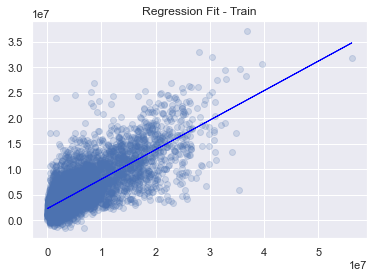

In [229]:
# Fitted vs actual
fit = lasso_poly2.fit(X_train_poly_scaled, y_train)

y_train_pred = fit.predict(X_train_poly_scaled)

# Prepare X and y from given data
X = y_train
y = y_train_pred

# Calculate parameters (intercept = theta[1] and slope = theta[0]) 
# of line using np.polyfit() function
theta = np.polyfit(X,y,1)

# Calculate y-axis values against x-values 
# according to parameters theta0, theta1 and theta2
y_line = theta[1] + theta[0] * X


# Plot the data points and best fit line
plt.scatter(y_train, y_train_pred, alpha=0.2)


plt.title("Regression Fit - Train")

# Line of best fit
plt.plot(X, y_line, color='blue', linewidth=1)

Text(0.5, 1.0, 'Residuals vs Predictions')

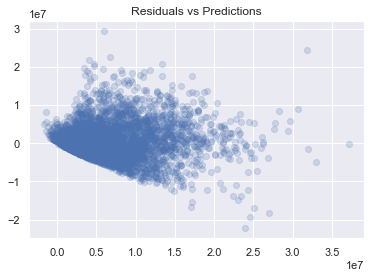

In [231]:
# Plot residuals vs predicted
resid_train = y_train - y_train_pred

plt.scatter(y_train_pred, resid_train, alpha=0.2)
plt.plot([0,200], [0,0])
plt.title("Residuals vs Predictions")

**- Residual plot shows a fan-shaped distribution of residuals, which is problematic because it suggests unequal variance of errors, or heteroskedasticity.**

**- This breaks the Equal Variance of Errors Assumption of Linear Regression.**

**- This suggests that this model may not perform well.**

**- However, coefficient and prediction values are still accurate for the model, even if the model isn't great.**

**- Try transformation of target (logarithmic, polynomial, or square root) to see if this will fix the problem.**

**- Rule of thumb: if max variance at any given prediction value is NOT greater than 4x the min value, the model is still ok!**

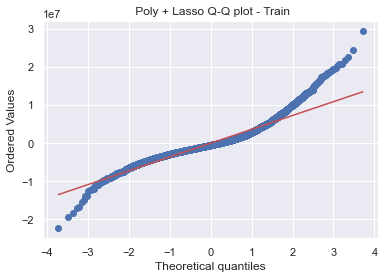

In [334]:
# Plot a normal q-q plot
stats.probplot(resid_train, dist="norm", plot=plt)
plt.title(" Poly + Lasso Q-Q plot - Train")
plt.show()


**- What we want: the points hugging the line closely without significant deviations. This will tell us that the residuals of the model are normally distributed with a mean of zero, that is, the error is random and not biased by some lack of information.**

**- What we see: an s-shaped Q-Q plot, heavy-tailed at both ends, which means that Normality of Errors Assumption is violated, especially at each tail of the data.**

**- Problematic Q-Q plot tells us that this model will not perform well in terms of predictions.**

**- Target and features do not need to be normally distributed, but can be the cause of normality issues.**

**- Try log transformation of the variables to see if this will fix the problem.**

**Heavy-tailed at both ends of Q-Q plot may indicate strong outliers.  Let's explore.**

In [160]:
train_set.sort_values(by='SALARY').tail(10)[['SEASON','PLAYER', 'AGE', 'MIN', 'PTS', 'SALARY']]

,SEASON,PLAYER,AGE,MIN,PTS,SALARY
7327,2013-01-01,Kobe Bryant,35,177,83,35433903.0
2537,2002-01-01,Shaquille O'Neal,31,2533,1841,35599015.0
2928,2003-01-01,Shaquille O'Neal,32,2465,1439,36605747.0
9039,2017-01-01,LeBron James,33,3026,2251,36919409.0
2535,2002-01-01,Kevin Garnett,27,3322,1883,38058583.0
9066,2017-01-01,Stephen Curry,30,1631,1346,38468739.0
3347,2004-01-01,Shaquille O'Neal,33,2497,1669,39667945.0
2929,2003-01-01,Kevin Garnett,28,3235,1987,41412563.0
122,1996-01-01,Michael Jordan,34,3109,2431,52258566.0
510,1997-01-01,Michael Jordan,35,3182,2357,56169715.0


In [161]:
train_set.sort_values(by='SALARY').head(10)[['SEASON','PLAYER', 'AGE', 'MIN', 'PTS', 'SALARY']]

,SEASON,PLAYER,AGE,MIN,PTS,SALARY
1440,1999-01-01,Ira Bowman,27,18,5,7403.0
1448,1999-01-01,Jason Miskiri,24,3,0,26126.0
4328,2006-01-01,Renaldo Major,25,27,5,26959.0
8716,2016-01-01,Dahntay Jones,36,12,9,27079.0
6894,2012-01-01,Henry Sims,23,5,4,29685.0
8276,2015-01-01,Nate Robinson,32,23,0,30120.0
4340,2006-01-01,Von Wafer,21,1,0,32539.0
6908,2012-01-01,Chris Wright,23,4,2,32984.0
7344,2013-01-01,Vander Blue,21,15,5,33550.0
7376,2013-01-01,Tony Mitchell,24,10,6,33550.0


**There is clearly a signficant range between the lowest salaries and the highest salaries, from 10^3 to 10^7 power, largely due to the way rookie contracts are constructed versus seasoned player contracts, but more importantly, the increase in salary caps throughout the years.  We'll have to keep the right-end outliers knowing this.**

### Log Transformation

**Recall the distplot of our target, SALARY, was highly right skewed. We can try to normalize it with a log transformation.**

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='SALARY', ylabel='Density'>

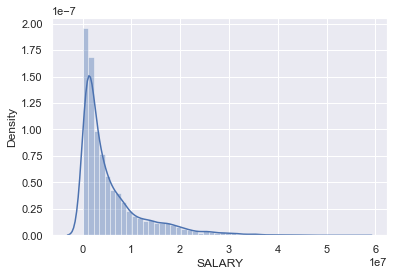

In [162]:
# Distribution plot of SALARY
sns.distplot(nba_sorted['SALARY'])

**-Log Transformation of Target-**

In [251]:
# Log Transformation of Target
nba_sorted['log_SALARY'] = np.log(nba_sorted['SALARY'])

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='log_SALARY', ylabel='Density'>

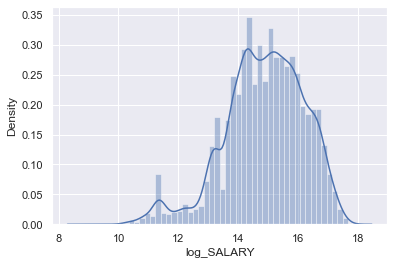

In [252]:
# View distribution plot of log transformation
sns.distplot(nba_sorted['log_SALARY'])

In [168]:
nba_sorted.head()

,SEASON,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,...,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SALARY,log_SALARY
0,1996-01-01,James Scott,25,8,8,0,32,1,0,8,...,3,2,2,0,5,0,0,-12,381449.0,12.851732
1,1996-01-01,Matt Maloney,25,82,57,25,2387,767,271,615,...,303,122,82,1,125,2,0,326,429130.0,12.969515
2,1996-01-01,Sam Mitchell,33,82,40,42,2051,766,269,603,...,79,93,51,20,232,2,0,-196,2080633.0,14.548183
3,1996-01-01,Sherman Douglas,30,79,33,46,2314,764,306,610,...,427,153,78,10,191,2,0,-120,6231496.0,15.645127
4,1996-01-01,Nick Anderson,29,63,39,24,2164,757,288,725,...,182,86,120,32,160,2,0,163,6571332.0,15.698227


In [ ]:
# Now run thru the same model with the log transformation of the target

In [254]:
# Hold more recent data for test set
test_set = nba_sorted.iloc[9117:, :] # 20% of dataset
train_set = nba_sorted.iloc[:9117, :] # 80% of dataset

# Use the log transformation of the target, Split train_set into train and val sets 

log_y = train_set['log_SALARY']
X = train_set.drop(columns=['SALARY', 'log_SALARY','PLAYER', 'SEASON'])

X_train, X_val, log_y_train, log_y_val = train_test_split(X, log_y, test_size=0.25, random_state=0)

# Create polynomial features
poly = PolynomialFeatures(degree=2)
X_train_poly = poly.fit_transform(X_train)

# Standard scale
scaler = StandardScaler()
X_train_poly_scaled = scaler.fit_transform(X_train_poly)

# Apply polynomial transformation and standard scale to to val set
X_val_poly = poly.transform(X_val)
X_val_poly_scaled = scaler.transform(X_val_poly)

# Lasso model
log_lasso_cv_poly = LassoCV()
log_lasso_cv_poly.fit(X_train_poly_scaled, log_y_train)
log_lasso_cv_poly.score(X_train_poly_scaled, log_y_train)
print('log_plus_poly_plus_lasso_r_sq = ', np.round(log_lasso_cv_poly.score(X_train_poly_scaled, log_y_train), 3))

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.4916005500135725, tolerance: 0.8048206781635668
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6067186601430876, tolerance: 0.8048206781635668
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.587697737596045, tolerance: 0.8048206781635668
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sk

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.9108101538831761, tolerance: 0.8132505988936901
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.8921219166240917, tolerance: 0.8132505988936901
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1.2098442851101936, tolerance: 0.8132505988936901
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\s

log_plus_poly_plus_lasso_r_sq =  0.544


C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.640e+02, tolerance: 1.007e+00
  model = cd_fast.enet_coordinate_descent(


In [171]:
# Score on the validation set
print('log_plus_poly_plus_lasso_r_sq_val = ', np.round(log_lasso_cv_poly.score(X_val_poly_scaled, log_y_val), 3))

log_plus_poly_plus_lasso_r_sq_val =  0.535


In [178]:
# Compare the r_squared values for models with and without log transformation of target, y
print('Log Transformation of Target + Polynomial Features + LASSO')
print('log_plus_poly_plus_lasso_r_sq = ', np.round(log_lasso_cv_poly.score(X_train_poly_scaled, log_y_train), 3))
print('log_plus_poly_plus_lasso_r_sq_val = ', np.round(log_lasso_cv_poly.score(X_val_poly_scaled, log_y_val), 3))
print('\n')
print('Polynomial Features + LASSO with optimal alpha = 8900')
print('poly_plus_lasso_r_sq_2 = ', np.round(lasso_poly2.score(X_train_poly_scaled, y_train),3))
print('poly_plus_lasso_r_sq_val_2 = ', np.round(lasso_poly2.score(X_val_poly_scaled, y_val),3))

Log Transformation of Target + Polynomial Features + LASSO
log_plus_poly_plus_lasso_r_sq =  0.544
log_plus_poly_plus_lasso_r_sq_val =  0.535


Polynomial Features + LASSO with optimal alpha = 8900
poly_plus_lasso_r_sq_2 =  0.589
poly_plus_lasso_r_sq_val_2 =  0.565


**The log transformation of our target DID NOT help to boost our R squared value. The best performative model is still LASSO regression + Polynomial transformation of the features with alpha=8900.** 

In [185]:
nba_sorted.head()

,SEASON,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,...,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SALARY,log_SALARY
0,1996-01-01,James Scott,25,8,8,0,32,1,0,8,...,3,2,2,0,5,0,0,-12,381449.0,12.851732
1,1996-01-01,Matt Maloney,25,82,57,25,2387,767,271,615,...,303,122,82,1,125,2,0,326,429130.0,12.969515
2,1996-01-01,Sam Mitchell,33,82,40,42,2051,766,269,603,...,79,93,51,20,232,2,0,-196,2080633.0,14.548183
3,1996-01-01,Sherman Douglas,30,79,33,46,2314,764,306,610,...,427,153,78,10,191,2,0,-120,6231496.0,15.645127
4,1996-01-01,Nick Anderson,29,63,39,24,2164,757,288,725,...,182,86,120,32,160,2,0,163,6571332.0,15.698227


In [255]:
# Let's make sure to drop the column log_SALARY since we are not going to use it
nba_sorted.drop(columns=['log_SALARY'], inplace=True)

nba_sorted.head()

,SEASON,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,...,REB,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SALARY
0,1996-01-01,James Scott,25,8,8,0,32,1,0,8,...,6,3,2,2,0,5,0,0,-12,381449.0
1,1996-01-01,Matt Maloney,25,82,57,25,2387,767,271,615,...,160,303,122,82,1,125,2,0,326,429130.0
2,1996-01-01,Sam Mitchell,33,82,40,42,2051,766,269,603,...,326,79,93,51,20,232,2,0,-196,2080633.0
3,1996-01-01,Sherman Douglas,30,79,33,46,2314,764,306,610,...,193,427,153,78,10,191,2,0,-120,6231496.0
4,1996-01-01,Nick Anderson,29,63,39,24,2164,757,288,725,...,304,182,86,120,32,160,2,0,163,6571332.0


# Retrain Chosen Model and Get Final Score on Test Set

**Chosen model: LASSO regression on (scaled) 2nd degree polynomial features**

In [201]:
# Fit a Lasso model on FULL dataset using scaled, polynomial features
test_set = nba_sorted.iloc[9117:, :] # 20% of dataset
train_set = nba_sorted.iloc[:9117, :] # 80% of dataset

y = train_set['SALARY']
X = train_set.drop(columns=['SALARY', 'PLAYER','SEASON'])

# Create polynomial features
poly = PolynomialFeatures(degree=2)
X_poly = poly.fit_transform(X)

# Standard scale
scaler = StandardScaler()
X_poly_scaled = scaler.fit_transform(X_poly)

# Lasso model
lasso_cv_poly = LassoCV(alphas=np.arange(5000,9000, 100))
lasso_cv_poly.fit(X_poly_scaled, y)
lasso_cv_poly.score(X_poly_scaled, y)
print('Train score = ', np.round(lasso_cv_poly.score(X_poly_scaled, y),3))

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1895219168418592.0, tolerance: 27062128447407.45
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 490975689615088.0, tolerance: 27062128447407.45
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 153526156900544.0, tolerance: 27062128447407.45
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklear

C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3130018801038656.0, tolerance: 26081030651239.49
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 726647909535680.0, tolerance: 26081030651239.49
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36029024880160.0, tolerance: 26081030651239.49
  model = cd_fast.enet_coordinate_descent_gram(
C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn

Train score =  0.589


C:\Users\sandr\anaconda3\envs\metis\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:648: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 4.033e+15, tolerance: 3.206e+13
  model = cd_fast.enet_coordinate_descent(


In [188]:
y_test = test_set['SALARY']
X_test = test_set.drop(columns=['SALARY', 'PLAYER','SEASON'])

# Apply the same polynomial and scaling transformations to test set, then score
X_test_poly = poly.transform(X_test)
X_test_poly_scaled = scaler.transform(X_test_poly)

# Score
test_score = lasso_cv_poly.score(X_test_poly_scaled, y_test)
print('Test score =', np.round(test_score, 3))

Test score = 0.556


### Comparing Training and Test Scores and What They Mean
    Tr = Te (low) -- underfit
    Tr = Te (high) -- good fit
    Tr > Te -- overfit
    Tr < Te -- outliers

In [200]:
print('Train score = ', np.round(lasso_cv_poly.score(X_poly_scaled, y),3))
print('Test score = ', np.round(test_score, 3))

Train score =  0.589
Test score =  0.556


**And so we see that train score is slightly higher than test score, but it is not uncommon for models to have better scores on their training data.**

## Residual Analysis
**Polynomial Regression + LassoCV**

In [183]:
import seaborn as sns
import patsy
import scipy.stats as stats
import matplotlib.pyplot as plt
sns.set()
%matplotlib inline

### Fitted vs Actual - Test

Text(0.5, 1.0, 'Regression Fit - Test')

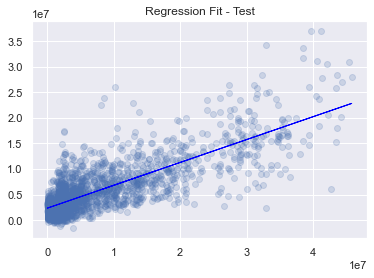

In [194]:
# Fitted vs actual
y_test_pred = fit.predict(X_test_poly_scaled)

# Prepare X and y from given data
X = y_test
y = y_test_pred

# Calculate parameters (intercept = theta[1] and slope = theta[0]) 
# of line using np.polyfit() function
theta = np.polyfit(X,y,1)

# Calculate y-axis values against x-values 
# according to parameters theta0, theta1 and theta2
y_line = theta[1] + theta[0] * X

# Plot the data points and best fit line
plt.scatter(y_test, y_test_pred, alpha=0.2)

# Line of best fit
plt.plot(X, y_line, color='blue', linewidth=1)

plt.title("Regression Fit - Test")

### Residual vs. Predicted - Test

Text(0.5, 1.0, 'Residuals vs Predictions - Test')

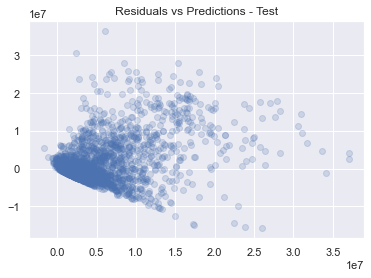

In [234]:
# Plot residuals vs predicted
resid_test = y_test - y_test_pred

plt.scatter(y_test_pred, resid_test, alpha=0.2)
plt.plot([0,200], [0,0])
plt.title("Residuals vs Predictions - Test")

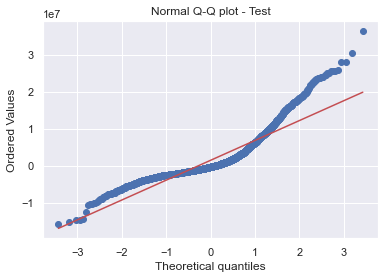

In [235]:
# Plot a normal q-q plot
stats.probplot(resid_test, dist="norm", plot=plt)
plt.title("Normal Q-Q plot - Test")
plt.show()

**Compare the Q-Q Plots**

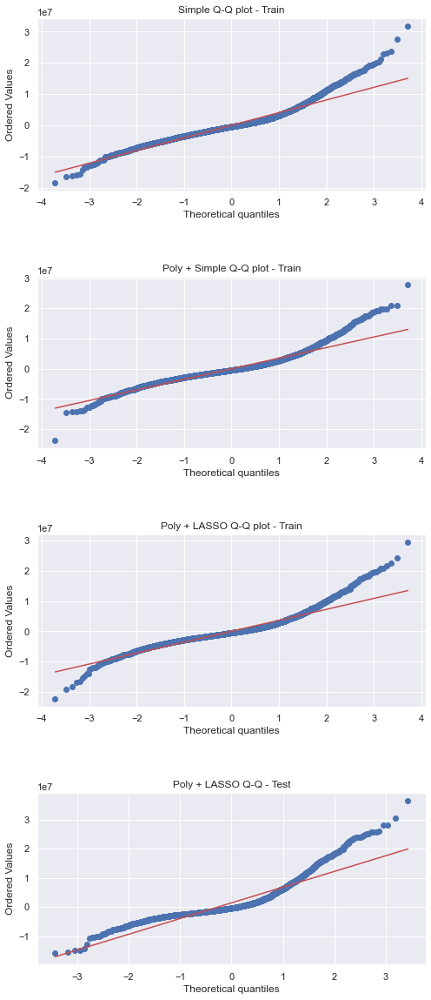

In [345]:
from matplotlib.gridspec import GridSpec

gs = GridSpec(4,1)
gs.update(wspace = 1.5, hspace = 0.5)
fig = plt.figure(figsize=([8,20]))

# Q-Q Plot - Simple Linear
ax=plt.subplot(gs[0,0])
ax=stats.probplot(resid_simple, dist="norm", plot=plt)
plt.title("Simple Q-Q plot - Train")

# Q-Q Plot - Polynomial + Simple Train
ax1=plt.subplot(gs[1,0])
ax1=stats.probplot(resid_train_simple_poly, dist="norm", plot=plt)
plt.title('Poly + Simple Q-Q plot - Train')

# Q-Q Plot - Polynomial + LASSO Train
ax2=plt.subplot(gs[2,0])
ax2=stats.probplot(resid_train, dist="norm", plot=plt)
plt.title('Poly + LASSO Q-Q plot - Train')

# Q-Q Plot - Polynomial + LASSO Test
ax3=plt.subplot(gs[3,0])
ax3=stats.probplot(resid_test, dist="norm", plot=plt)
plt.title('Poly + LASSO Q-Q - Test')

plt.show()

**The training data fit the red line better, which may indicate that our model is overfit.**

### Root Mean Squared Error on Training Data

In [225]:
# Check the RMSE (root mean squared error) on the training data
from sklearn.metrics import mean_squared_error
from math import sqrt

sqrt(mean_squared_error(y_train, y_train_pred))

3792650.9639228573

### Root Mean Squared Error on Test Data

In [226]:
# Check the RMSE (root mean squared error) on the test data
sqrt(mean_squared_error(y_test, y_test_pred))

6026061.168859491

**The RMSE for test is much higher than that of the train set.  This may be mostly due to the fact that our test set consists of more recent dates and respectively, salaries.  NBA salary caps have been incrementally increasing throughout the years.  Higher salaries in more recent data may cause more outliers.**

# Salary Prediction Using Our Chosen Model

In [223]:
#NBA Player - 
lasso_cv_poly.predict([X_poly_scaled[0]])

array([1783014.26357686])

In [48]:
# NBA player - Stephen Curry at age 22
trae_young = nba_sorted[(nba_sorted['PLAYER'] == 'Trae Young') & (nba_sorted['SEASON'] == 2021)]
trae_young

,SEASON,PLAYER,AGE,GP,W,L,MIN,PTS,FGM,FGA,...,REB,AST,TOV,STL,BLK,PF,DD2,TD3,+/-,SALARY
11396,2021,Trae Young,23,76,40,36,2652,2155,711,1544,...,284,737,303,72,7,128,42,0,159,8326471.0


In [217]:
trae_young =[23,76,40,23,2652,2155,711,1544,46.0,233,610,
              38.2,500,553,90.4,50,234,284,737,303,72,7,128,42,0,159]

#trae_young_pred = lasso_cv_poly.predict(trae_young)

In [ ]:
test_1 = {'AGE':23,
 'GP': 76,
 'W':40,
 'L':23,
 'MIN':2652,
 'PTS':2155,
 'FGM':711,
 'FGA':1544,
 'FG%':46.0,
 '3PM':233,
 '3PA':610,
 '3P%':38.2,
 'FTM':500,
 'FTA':553,
 'FT%':90.4,
 'OREB':50,
 'DREB':234,
 'REB':284,
 'AST':737,
 'TOV':303,
 'STL':72,
 'BLK':7,
 'PF':128,
 'DD2':42,
 'TD3':0,
 '+/-':159}